In [1]:
import numpy as np              
import pandas as pd              
import plotly.express as px              
from plotly.subplots import make_subplots              
import plotly.graph_objects as go

In [2]:
df = np.loadtxt('Train_Dst_NoAuction_DecPre_CF_7.txt')

In [5]:
df.shape

(149, 254750)

In [6]:
df2 = pd.DataFrame(df[:40, :].T)

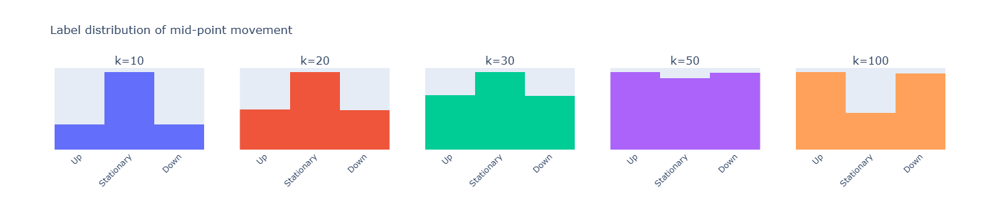

In [10]:
labels = ['Up', 'Stationary', 'Down']
def print_distribution(data_set):
    fig = make_subplots(rows=1, cols=5, subplot_titles=('k=10', 'k=20', 'k=30', 'k=50', 'k=100') )
    fig.add_trace(go.Histogram(x=data_set[144, :], histnorm='percent'), row=1, col=1)
    fig.add_trace(go.Histogram(x=data_set[145, :], histnorm='percent'), row=1, col=2)
    fig.add_trace(go.Histogram(x=data_set[146, :], histnorm='percent'), row=1, col=3)
    fig.add_trace(go.Histogram(x=data_set[147, :], histnorm='percent'), row=1, col=4)
    fig.add_trace(go.Histogram(x=data_set[148, :], histnorm='percent'), row=1, col=5)

    fig.update_layout(title='Label distribution of mid-point movement', width=700, height=300, showlegend=False)
    fig.update_xaxes(ticktext=labels, tickvals=[1, 2, 3], tickangle=-45)
    fig.update_yaxes(visible=False, showticklabels=False)
    fig.layout.yaxis.title.text = 'percent'
    fig.show()

print_distribution(df)

In [11]:
df_ask_prices = df2.loc[:, range(0, 40, 4)]
df_ask_volumes = df2.loc[:, range(1, 40, 4)]
df_bid_prices = df2.loc[:, range(2, 40, 4)]
df_bid_volumes = df2.loc[:, range(3, 40, 4)]

In [14]:
df_bid_prices = df_bid_prices[df_bid_prices.columns[::-1]]
df_bid_volumes = df_bid_volumes[df_bid_volumes.columns[::-1]]

In [16]:
df_prices = df_bid_prices.join(df_ask_prices, how='outer')
df_volumes = df_bid_volumes.join(df_ask_volumes, how='outer')
df_prices.columns = range(1, 21)
df_volumes.columns = range(1, 21)

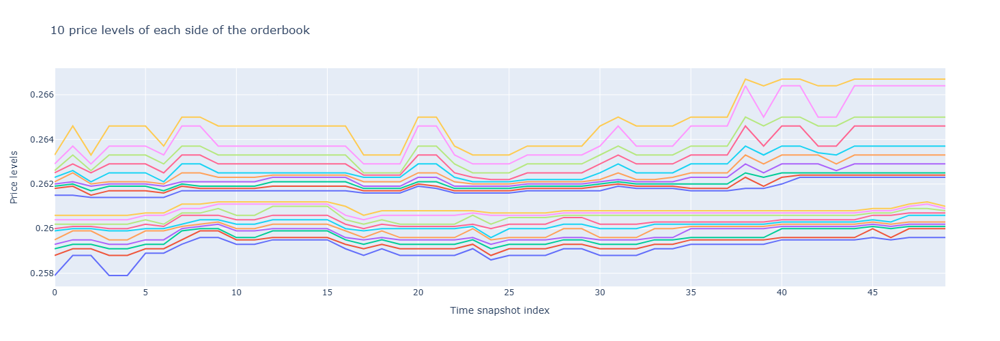

In [17]:
fig = go.Figure()
for i in df_prices.columns:
    fig.add_trace(go.Scatter(y=df_prices[:50][i]))

fig.update_layout(title='10 price levels of each side of the orderbook', 
                  xaxis_title='Time snapshot index',
                  yaxis_title='Price levels',
                  height=500,
                  showlegend=False,
                 )
fig.show()

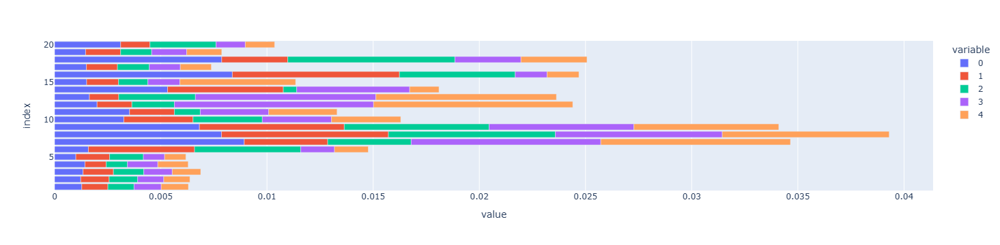

In [18]:
px.bar(df_volumes.head(5).transpose(), orientation='h')

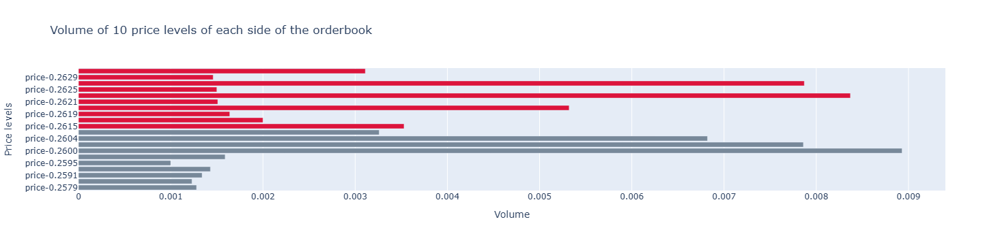

In [22]:
colors = ['lightslategrey',] * 10
colors = colors + ['crimson',] * 10

fig = go.Figure()
timestamp = 0
fig.add_trace(go.Bar(
    y=['price-'+'{:0.4f}'.format(x) for x in df_prices.iloc[timestamp].tolist()],
    x=df_volumes.iloc[timestamp].tolist(),
    orientation='h',
    marker_color=colors
))
fig.update_layout(
    title='Volume of 10 price levels of each side of the orderbook',
    xaxis_title='Volume',
    yaxis_title='Price levels',
)
fig.show()

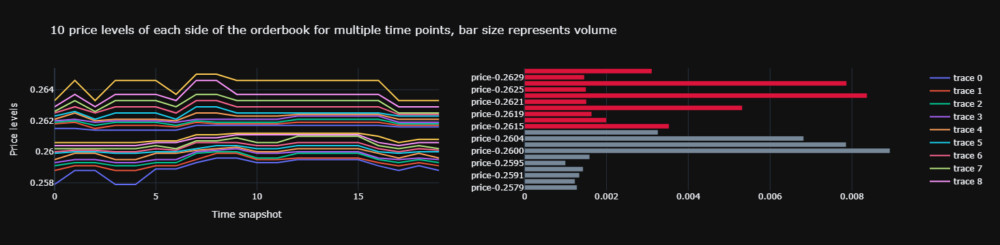

In [25]:
fig = make_subplots(rows=1, cols=2)
for i in df_prices.columns:
    fig.add_trace(go.Scatter(y=df_prices.head(20)[i]), row=1, col=1)
timestamp = 0
fig.add_trace(go.Bar(                
    y= ['price-'+'{:.4f}'.format(x) for x in df_prices.iloc[timestamp].tolist()],              
    x= df_volumes.iloc[timestamp].tolist(),
    orientation='h',
    marker_color=colors
), row=1, col=2)
                
fig.update_layout(                
    title='10 price levels of each side of the orderbook for multiple time points, bar size represents volume',
    xaxis_title="Time snapshot",
    yaxis_title="Price levels",
    template='plotly_dark'
)               
fig.show()

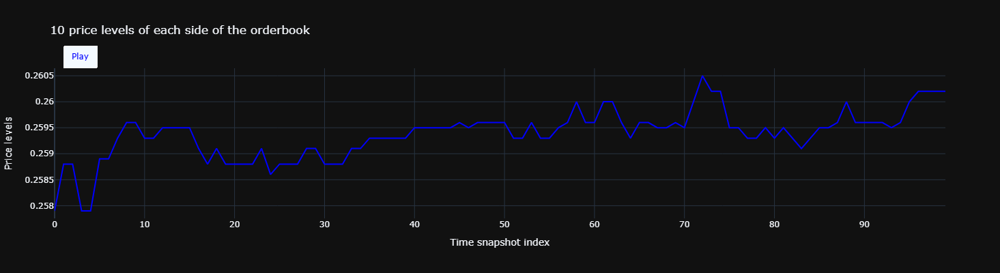

In [28]:
widthOfTime = 100                
priceLevel = 1

fig = go.Figure(               
    data=[go.Scatter(x=df_prices.index[:widthOfTime].tolist(), y=df_prices[:widthOfTime][priceLevel].tolist(),
                     name="frame",               
                     mode="lines",                
                     line=dict(width=2, color="blue")), ],
                    layout=go.Layout(width=1000, height=400,                
#                      xaxis=dict(range=[0, 100], autorange=False, zeroline=False),                
#                      yaxis=dict(range=[0, 1], autorange=False, zeroline=False),                
                     title="10 price levels of each side of the orderbook",                
                     xaxis_title="Time snapshot index",                
                     yaxis_title="Price levels",                
                     template='plotly_dark',                
                     hovermode="closest",                
                     updatemenus=[dict(type="buttons",                
                                       showactive=True,                
                                       x=0.01,                
                                       xanchor="left",                
                                       y=1.15,                
                                       yanchor="top",                
                                       font={"color":'blue'},                
                                       buttons=[dict(label="Play",                
                                                     method="animate",                
                                                     args=[None])])]),         
    frames=[go.Frame(                
        data=[go.Scatter(                
            x=df_prices.iloc[k:k+widthOfTime].index.tolist(),                
            y=df_prices.iloc[k:k+widthOfTime][priceLevel].tolist(),                
            mode="lines",               
            line=dict(color="blue", width=2))                
        ]) for k in range(widthOfTime, 1000)]               
)
                
fig.show()

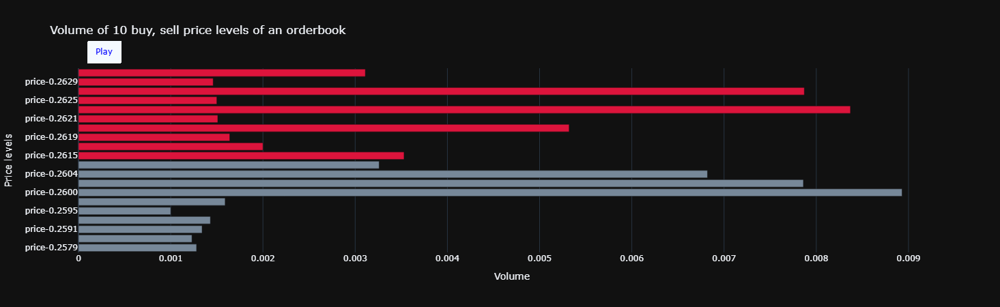

In [38]:
timeStampStart = 100
fig = go.Figure(
    data=[go.Bar(y= ['price-'+'{:.4f}'.format(x) for x in df_prices[:timeStampStart].values[0].tolist()], 
                 x=df_volumes[:timeStampStart].values[0].tolist(), orientation='h', name="priceBar", marker_color=colors), ],
    layout=go.Layout(width=800, height=450,
    title="Volume of 10 buy, sell price levels of an orderbook",
    xaxis_title="Volume",
    yaxis_title="Price levels",
    template='plotly_dark',                
    hovermode="closest",                
    updatemenus=[dict(type="buttons",               
        showactive=True,               
        x=0.01,                
        xanchor="left",                
        y=1.15,                
        yanchor="top",                
        font={"color":'blue'},                
        buttons=[dict(label="Play",                
        method="animate",                
        args=[None])])]),                
    frames=[go.Frame(                
        data=[go.Bar(y= ['price-'+'{:.4f}'.format(x) for x in df_prices.iloc[k].values.tolist()],                
        x=df_volumes.iloc[k].values.tolist(),                
        orientation='h',                
        marker_color=colors)],                
    layout=go.Layout(width=800, height=450,                
        title="Volume of 10 buy, sell price levels of an orderbook [Snapshot=" + str(k) +"]",                
        xaxis_title="Volume",                
        yaxis_title="Price levels",                
        template='plotly_dark',                
        hovermode="closest")) for k in range(timeStampStart, 500)]               
)           
fig.show()

## My Own animatation of a graph

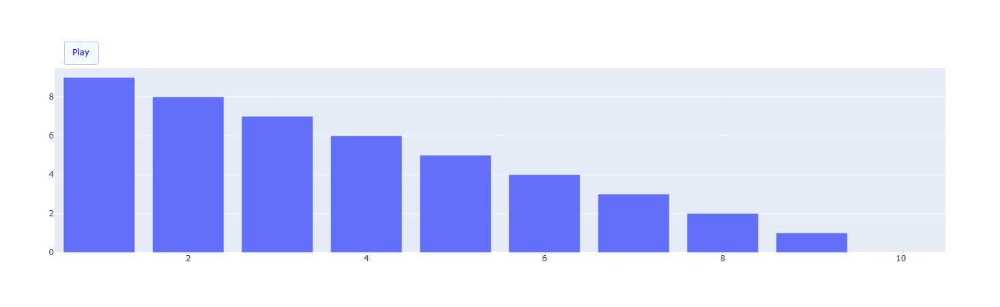

In [67]:
# x_s = list(range(0, 1000))
# y_s = list(range(0, 1000))

fig = go.Figure(
        data=[go.Bar(y=[x for x in range(0, 10)],
                     x=[x for x in range(10, 0, -1)])
                     ],
                layout=go.Layout(width=800, height=450, 
                                 updatemenus=[dict(type='buttons', 
                                                   showactive=True, 
                                                   x=0.01, 
                                                   xanchor='left', 
                                                   y=1.15, 
                                                   yanchor='top', 
                                                   font={'color': 'blue'},
                                               buttons=[dict(label='Play', method='animate', args=[None]) ]
                                                  )]
                             ),
# this controls the animation
frames=[go.Frame(
    data=[go.Scatter(
        x=x_s, # in reality 'k' would loop us through the index of the dataframe
        y=x_s,
        mode='lines',
        line=dict(color='blue', width=2))
    ]) for k in range(0, 1000)]
        )

fig.show()